In [10]:
# own try to receive data -> does not realy work
import sqlite3
import io
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Connect to the SQLite database
conn = sqlite3.connect('batcallsv14.db')
cursor = conn.cursor()

# Retrieve the image data as a byte array
query = "SELECT arr, target FROM batcalls"


df = pd.read_sql_query(query, conn)

# Close the connection
conn.close()


# Function to convert binary data to NumPy array
def convert_to_array(binary_data):
    return np.frombuffer(binary_data, dtype=np.int16)

# Apply the conversion function to the entire column
spectrogram_arr = df['arr'].apply(convert_to_array)

# Replace the previous column with the extracted features
df = df.drop('arr', axis=1)
df_spectrogram = spectrogram_arr.apply(pd.Series)

df_spectrogram.info()
statistics = df_spectrogram.describe()
print(f'Length of DataFrame: {len(df_spectrogram)}')

statistics_count = statistics.loc['count']
nan_indexes = statistics_count[statistics_count < len(df_spectrogram)]

statistics_count.to_csv('statistics_count.csv')
nan_indexes.to_csv('nan_indexes.csv')
statistics.to_csv('BatHunting_stats.csv', index=False)

# Concatenate the split columns with the original DataFrame
df = pd.concat([df, df_spectrogram], axis=1)

#print(df)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51719 entries, 0 to 51718
Columns: 8884 entries, 0 to 8883
dtypes: float64(8884)
memory usage: 3.4 GB
Length of DataFrame: 51719


In [1]:
# view data gathered the provided way
import librosa
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import io
import sqlite3
import os
from scipy.signal import butter, lfilter
from tensorflow import keras
from tensorflow.keras.layers import Input, Dense, Flatten, MaxPooling2D, Conv2D
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.activations import relu, tanh, linear
from tensorflow.keras.utils import Progbar
from joblib import Parallel, delayed #Paralleize calculation

# check if tensorflow uses GPU
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

2023-12-30 15:17:16.632955: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-30 15:17:16.633076: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-30 15:17:16.698895: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-12-30 15:17:16.830657: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-12-30 15:17:18.041241: W tensorflow/compiler/tf2

Num GPUs Available:  1


In [2]:
targets = [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18] 

all_rows = []

# Make array from the binary data in the database
def _convert_array(text):
	out = io.BytesIO(text)
	out.seek(0)
	return np.load(out, allow_pickle=True)

# Make sqlite3 binary from the given array (probably for saving the array in the database)
def _adapt_array(arr):
	out = io.BytesIO()
	np.save(out, arr)
	out.seek(0)
	return sqlite3.Binary(out.read())

sqlite3.register_adapter(np.ndarray, _adapt_array)
sqlite3.register_converter("ARRAY", _convert_array)

View data and make sure there are no NaN values:

In [ ]:
# More or less pointless
def view_data(target):
    # Connect to the SQLite database
    conn = sqlite3.connect('batcallsv14.db', detect_types=True)
    cursor = conn.cursor()
    query = f"SELECT arr FROM batcalls where target = {target}"
    df = pd.read_sql_query(query, conn)
    df = pd.DataFrame(df['arr'].tolist())
    
    statistics = df.describe()
    name = f'statistics/Bat.describe_target{target}.csv'
    statistics.to_csv(name)
    return df

dataframes = Parallel(n_jobs=-3, prefer="threads")(delayed(view_data)(target) for target in targets)
df = pd.concat(dataframes)
statistics = df.describe()
statistics.to_csv('full_statistic.csv')

# Total NaN count across the DataFrame
total_nan_count = df.isna().sum().sum()
# NaN count per column
nan_count_per_column = df.isna().sum()
print("Total NaN count:", total_nan_count)
print("NaN count per column:\n", nan_count_per_column)

In [4]:
# Functions to get data
def get_target_data(target, limit=0, no_target=False):
    conn = sqlite3.connect('batcallsv14.db', detect_types=True)
    cursor = conn.cursor()
    lmt = "" if limit<=0 else f"LIMIT {limit}"
    query = f"SELECT target, arr FROM batcalls where target = {target} {lmt}"
    df = pd.read_sql_query(query, conn)
    conn.close()
    df_arr = pd.DataFrame(df['arr'].tolist())
    if no_target:
        return df_arr
    df = df.drop(columns=['arr'])
    df = pd.concat([df, df_arr], axis=1)
    return df

def get_all_data(targets=[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18], limit=0, no_target=False):
    all_df = Parallel(n_jobs=-3, prefer="threads")(delayed(get_target_data)(target, limit, no_target) for target in targets)
    return all_df

def get_data(targets=[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18], limit=0, no_target=False):
    all_df = Parallel(n_jobs=-3, prefer="threads")(delayed(get_target_data)(target, limit, no_target) for target in targets)
    df = pd.concat(all_df)
    return df

# try to visualize only the maximum values per species
def spectrogram_range(target):
    df = get_target_data(target, limit=0, no_target=True)
    max_vals = df.max()
    min_vals = df.min()
    
    abs_pos = max_vals.abs()
    abs_neg = min_vals.abs()
    mask = (abs_pos > abs_neg).astype(bool)
    return min_vals.where(mask, max_vals), max_vals.where(mask, min_vals)

def get_targets():
    conn = sqlite3.connect('batcallsv14.db', detect_types=True)
    cursor = conn.cursor()
    query = f"SELECT target, bat FROM batcalls group by target, bat order by target"
    df = pd.read_sql_query(query, conn)
    conn.close()
    return df

In [27]:
# try to visualize the data all at once
# -> NO GOOD IDEA
targets = [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]
all_df = Parallel(n_jobs=-3, prefer="threads")(delayed(get_target_data)(
    target, 50
) for target in targets)

colors = [
    'red','green','blue','yellow','orange','purple','cyan','magenta','lime','pink','teal',
    'lavender','brown','gray','olive','maroon','navy','chartreuse'
]
plt.figure(figsize=(655, 20))
c=0
for df in all_df:
    df = df.drop(columns=['target'])
    for i, column in enumerate(df.columns, start=1):
        plt.plot([i]*len(df), df[column], color=colors[c], linestyle='-')
    c+=1

plt.xlabel('Time')
plt.ylabel('Frequenzy')
plt.xticks(range(1, len(df.columns) + 1, 100))
plt.title('Frequencies')
plt.savefig('BatCalls.png')
plt.show()

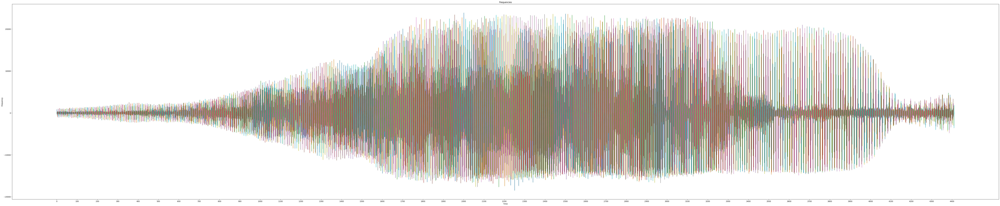

In [34]:
# try to visualize the data seperate

def plot_species(target=1, limit=0):
    df = get_target_data(target, limit=limit, no_target=True)
    fig, ax = plt.subplots(figsize=(100, 20))
    for i, column in enumerate(df.columns, start=1):
        ax.plot([i]*len(df), df[column], linestyle='-')
    ax.set_xlabel('Time')
    ax.set_ylabel('Frequenzy')
    ax.set_xticks(range(0, len(df.columns) + 1, 100))
    ax.set_title('Frequencies')
    fig.savefig('BatCalls_target1.png')
    return fig
    
fig = plot_species(1, 50)
plt.show()
plt.close(fig)

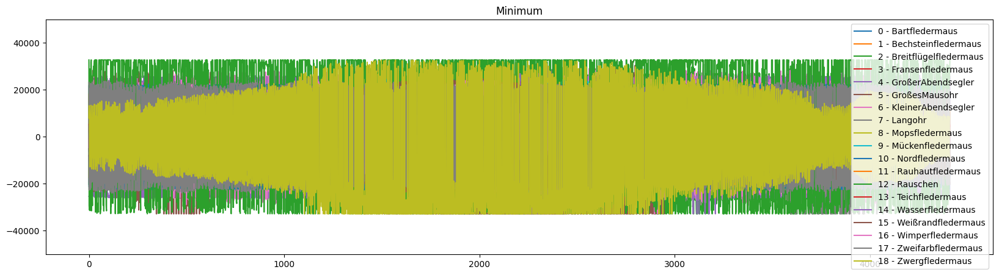

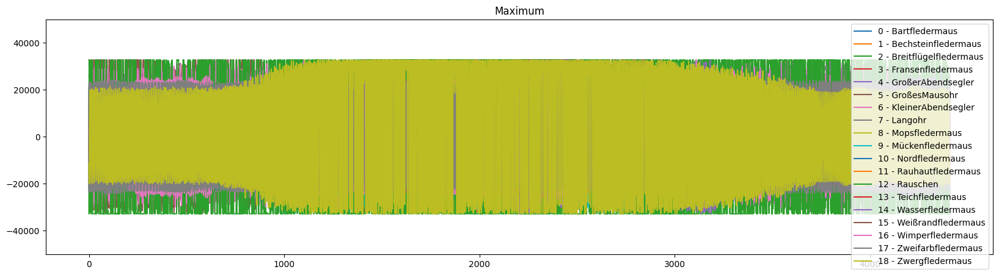

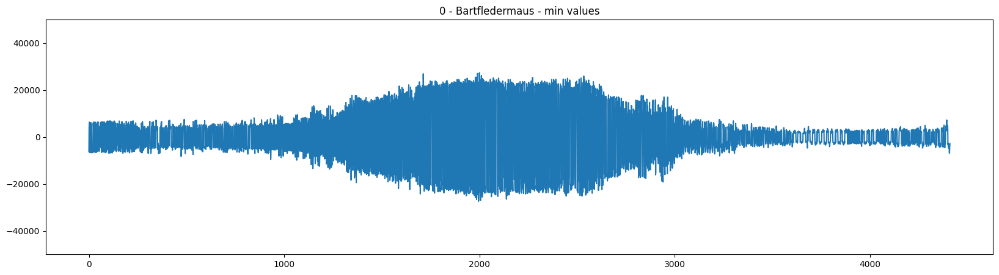

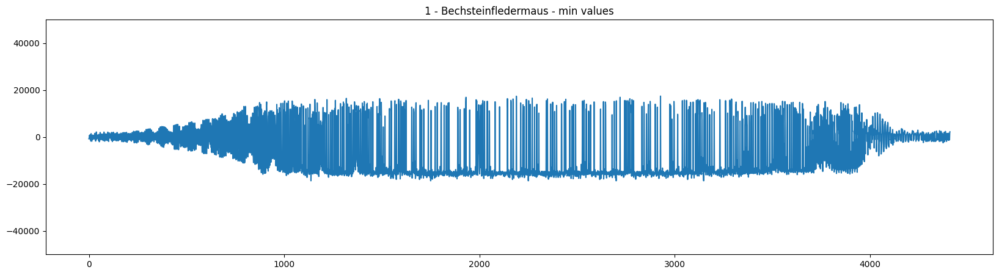

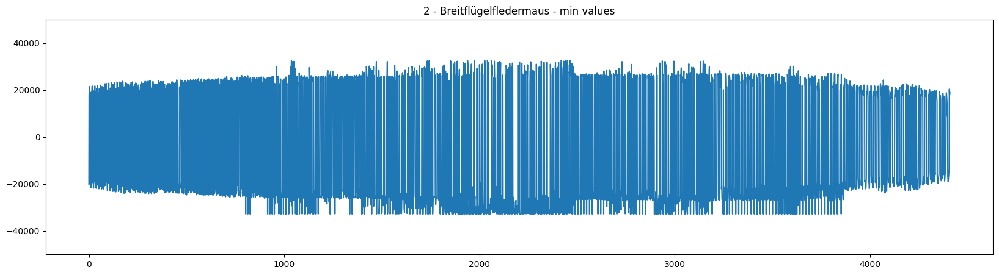

...

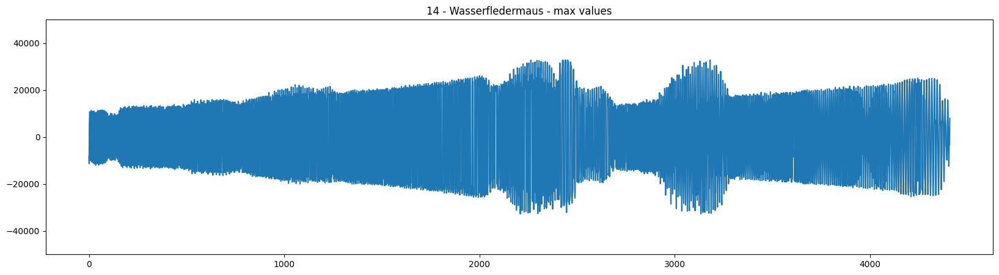

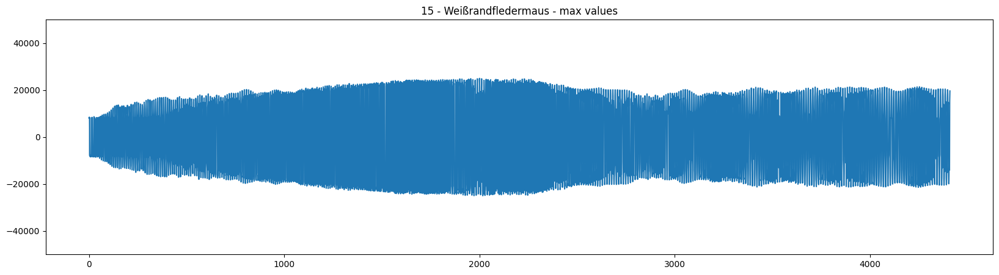

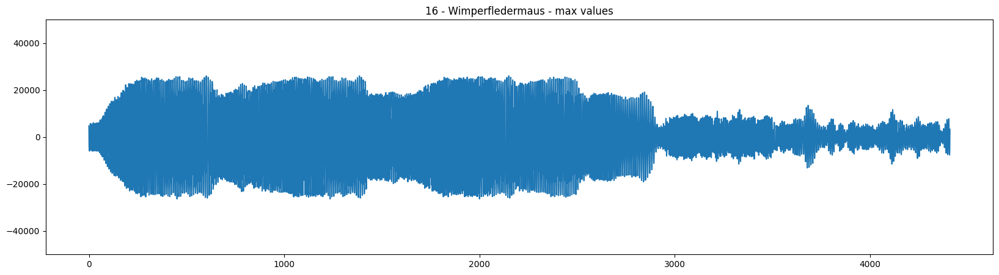

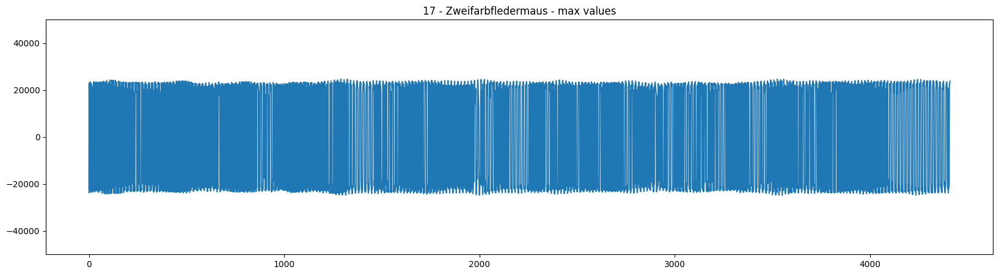

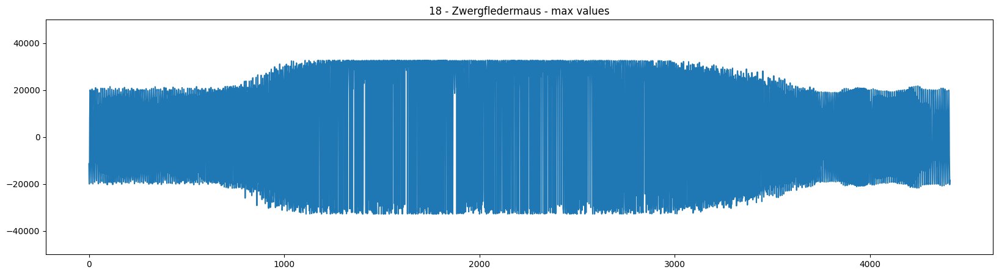

In [44]:

    
all_series = Parallel(n_jobs=-3, prefer="threads")(delayed(spectrogram_range)(target) for target in range(0,19))
targets = get_targets()
targets = targets.apply(lambda row: ' - '.join(row.astype(str)), axis=1)
    
for i, s in enumerate(all_series):
    ax = s[0].plot(figsize=(20, 5))
ax.legend(targets)
ax.set_title('Minimum')
ax.set_ylim([-50000, 50000])
fig = plt.gcf()
fig.savefig('BatCalls_max_ledgend.png')
plt.show()
plt.close(fig)

for i, s in enumerate(all_series):
    ax = s[1].plot(figsize=(20, 5))
ax.legend(targets)
ax.set_title('Maximum')
ax.set_ylim([-50000, 50000])
fig = plt.gcf()
fig.savefig('BatCalls_min_ledgend.png')
plt.show()
plt.close(fig)

for target, series in zip(targets, all_series):
    ax = series[0].plot(figsize=(20, 5))
    ax.set_title(f'{target} - min values')
    ax.set_ylim([-50000, 50000])
    fig = plt.gcf()
    fig.savefig(f'Spectrogram_small/{target}_max.png')
    plt.show()
    plt.close(fig)
    
for target, series in zip(targets, all_series):
    ax = series[1].plot(figsize=(20, 5))
    ax.set_title(f'{target} - max values')
    ax.set_ylim([-50000, 50000])
    fig = plt.gcf()
    fig.savefig(f'Spectrogram_small/{target}_min.png')
    plt.show()
    plt.close(fig)

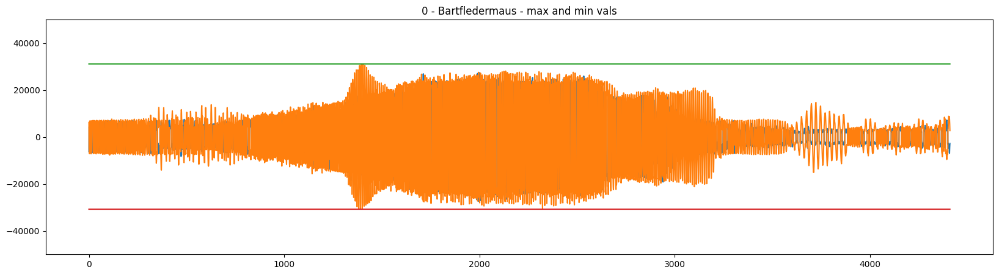

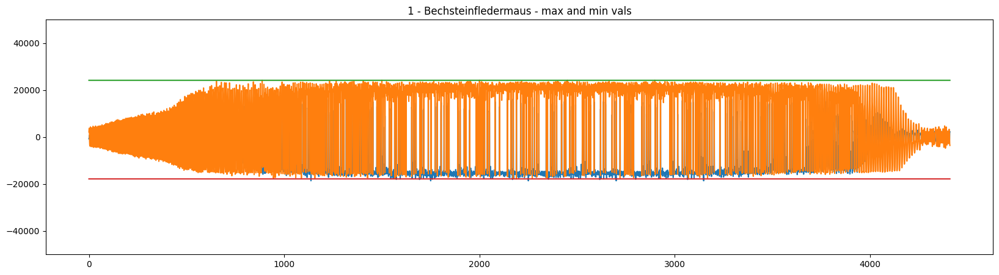

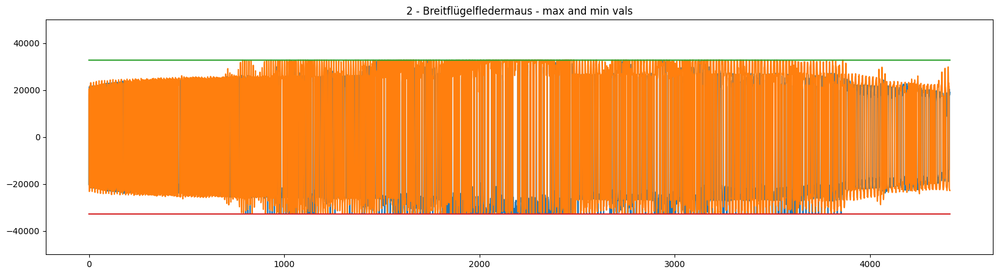

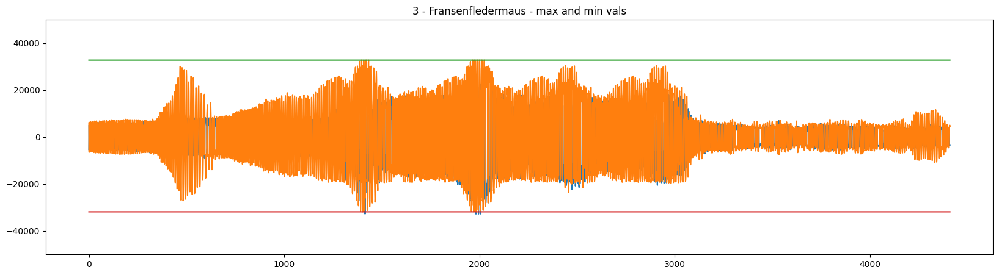

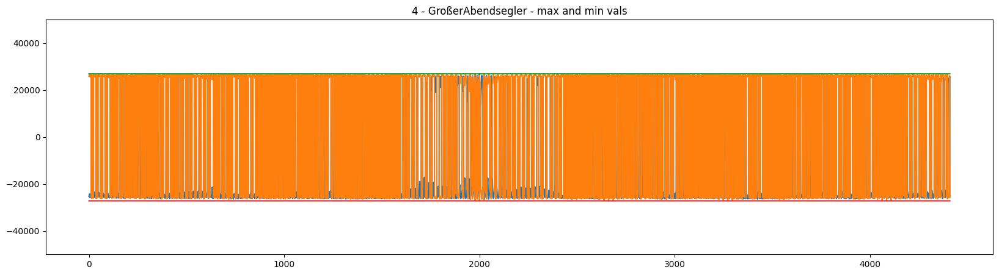

...

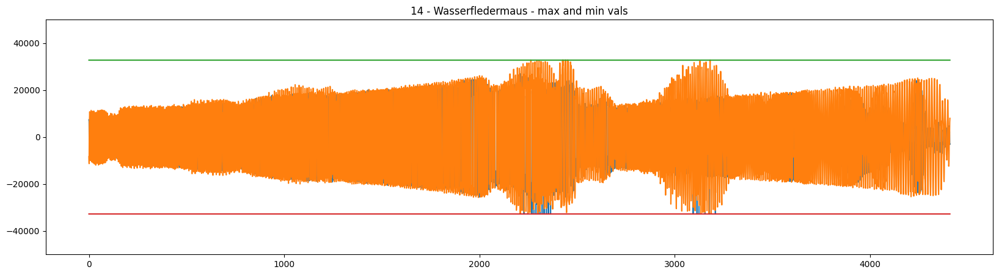

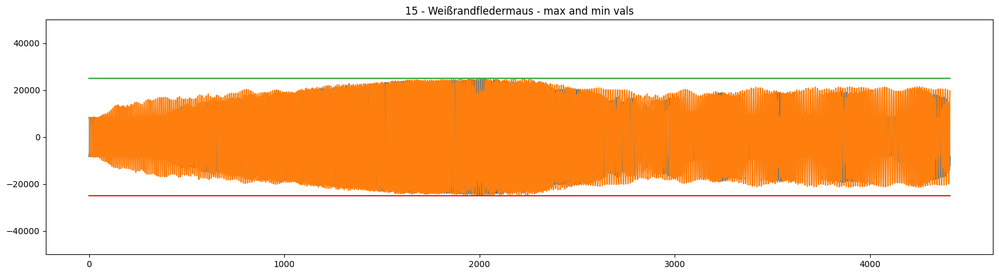

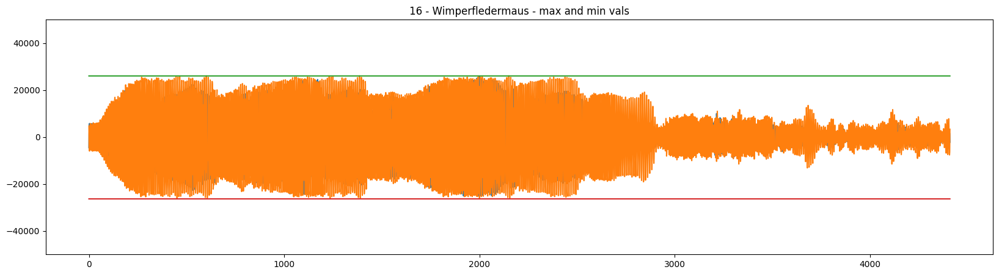

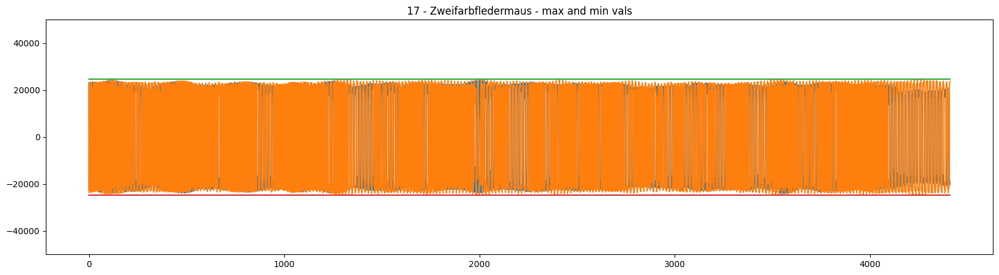

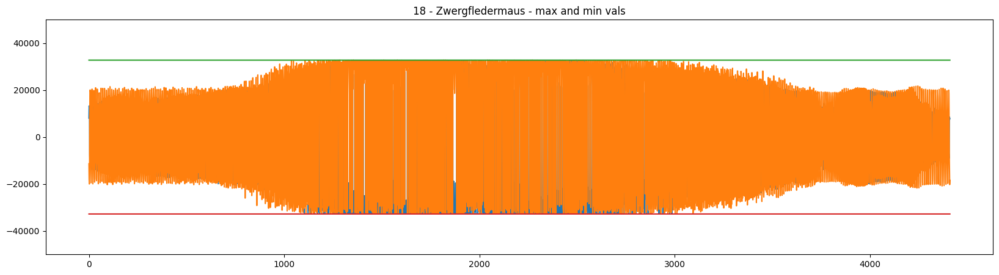

In [48]:
for target, series in zip(targets, all_series):
    max_line = pd.Series([series[1].max()]).repeat(len(series[1])).reset_index(drop=True)
    min_line = pd.Series([series[1].min()]).repeat(len(series[1])).reset_index(drop=True)
    ax = series[0].plot(figsize=(20, 5))
    ax = series[1].plot(figsize=(20, 5))
    ax = max_line.plot(figsize=(20, 5))
    ax = min_line.plot(figsize=(20, 5))
    ax.set_title(f'{target} - max and min vals')
    ax.set_ylim([-50000, 50000])
    fig = plt.gcf()
    fig.savefig(f'Spectrogram_small/{target}_combi.png')
    plt.show()
    plt.close(fig)

Die Visualisierung der Daten legt nahe das für einige Feldermausarten die Aufnahmegeräte einen zu geringen Frequenzbereich abgedeckt haben (2 - Breitflügelfledermaus, 4 - Großer Abendsegler, 5 - Großes Muasohr, 7 - Langohr, 8 - Mopsfledermaus, 10 - Nordfledermaus, 18 - Zwergfledermaus). Für zwei Arten (4 - Großer Abendsegler, 10 - Nordfledermaus) hören die Frequenzbereiche bereits (ca.) unter -20.000 bzw. über 20.000 auf. Die Vermutung liegt nahe, dass für diese Aufnahmen ein anderes Aufnahmegerät als für andere Aufnahmen verwendet wurde.

In [8]:
# Get an overview of the distribution over targets -> at least 327 targets per species
conn = sqlite3.connect('batcallsv14.db', detect_types=True)
cursor = conn.cursor()
query = f"SELECT count(*), target, bat FROM batcalls group by target, bat"
distribution = pd.read_sql_query(query, conn)
print(distribution)
conn.close()

    count(*)  target                    bat
0       2393       0         Bartfledermaus
1        329       1    Bechsteinfledermaus
2       2681       2  Breitflügelfledermaus
3       3040       3      Fransenfledermaus
4       3005       4      GroßerAbendsegler
5       2366       5          GroßesMausohr
6       2884       6     KleinerAbendsegler
7        411       7                Langohr
8        327       8         Mopsfledermaus
9        566       9       Mückenfledermaus
10      1245      10         Nordfledermaus
11      4695      11      Rauhautfledermaus
12      4713      12               Rauschen
13      2142      13        Teichfledermaus
14      6074      14       Wasserfledermaus
15      4619      15     Weißrandfledermaus
16       849      16       Wimperfledermaus
17      1495      17     Zweifarbfledermaus
18      7885      18        Zwergfledermaus


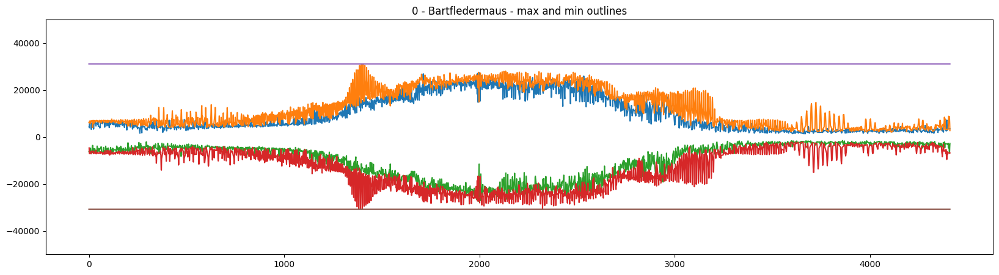

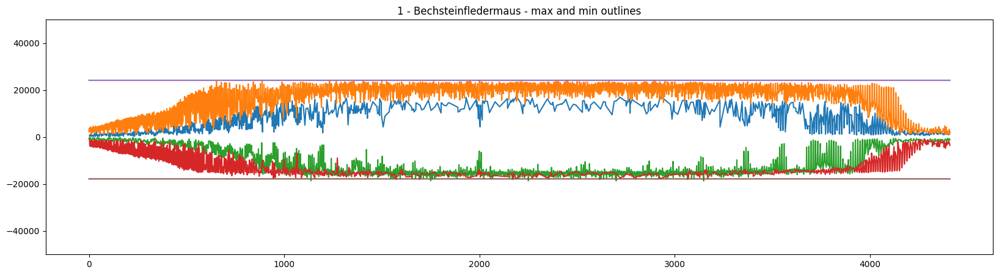

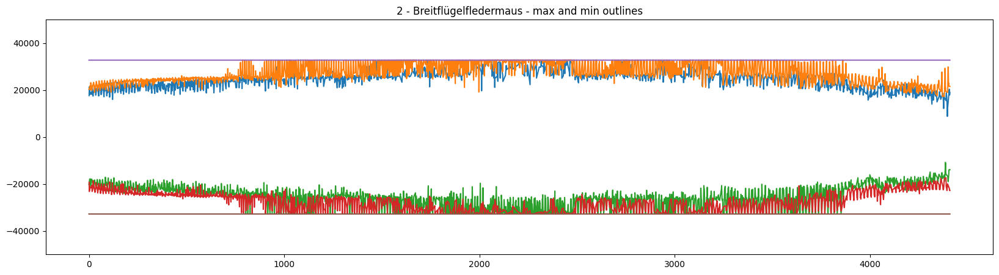

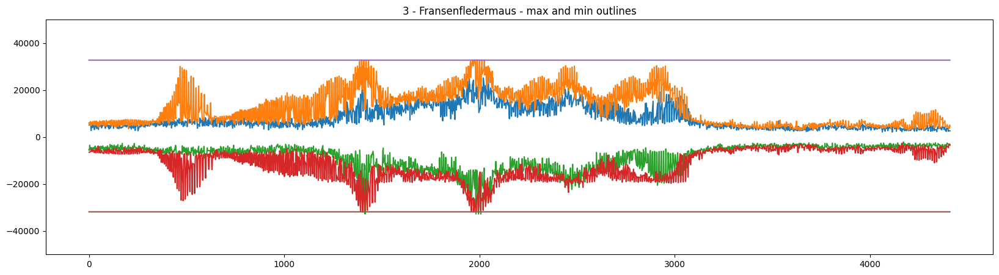

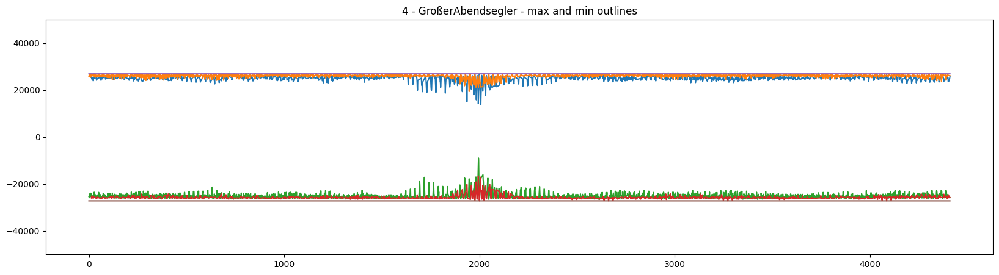

...

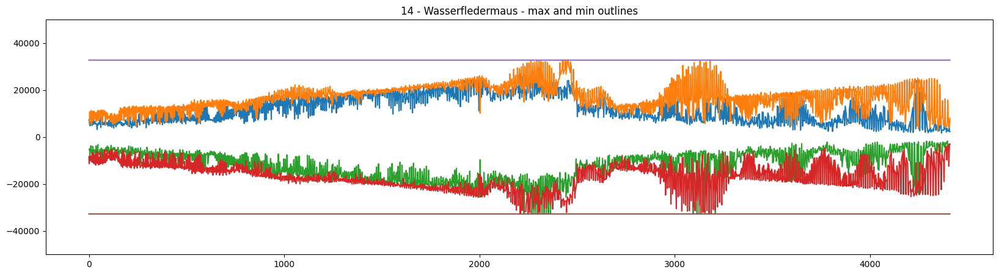

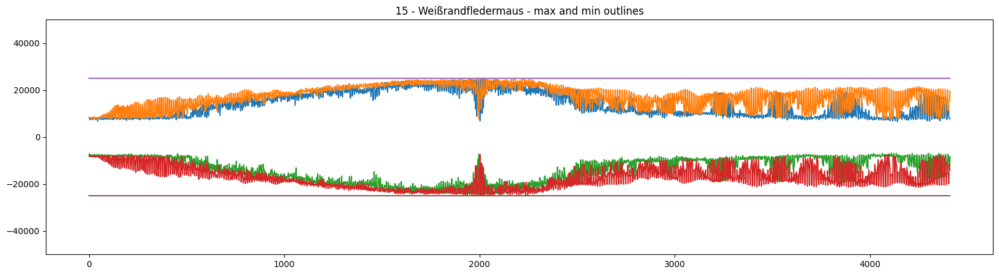

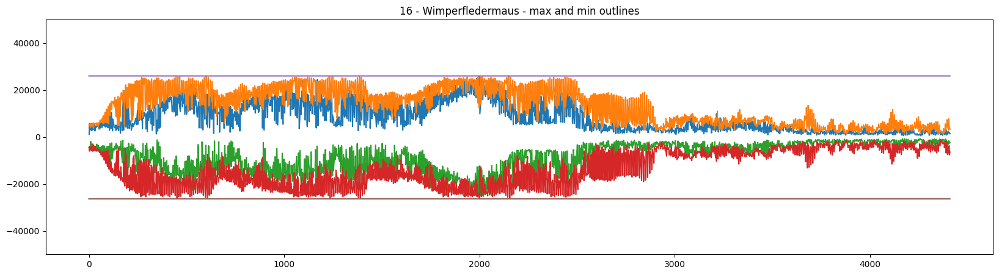

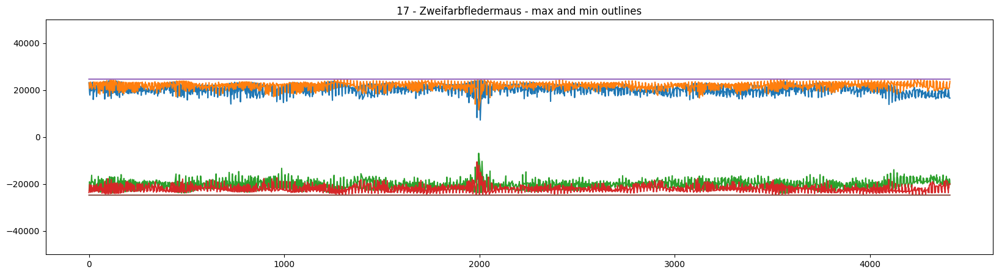

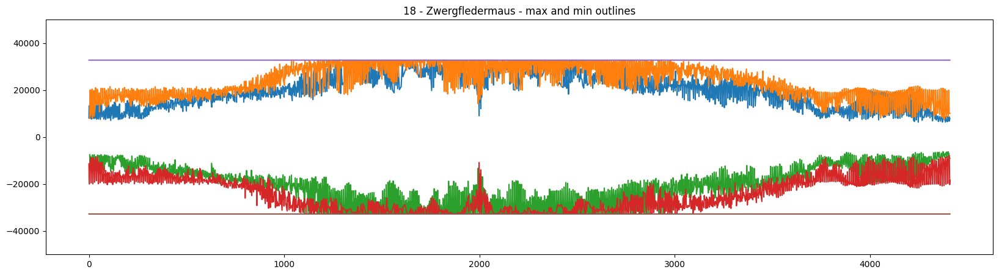

In [56]:
#TODO positive und negative Werte seperieren und Lücken interpolieren
for target, series in zip(targets, all_series):
    min_series = series[0]
    max_series = series[1]

    positive_series_min = min_series.copy()
    positive_series_min[positive_series_min < 0] = np.nan

    negative_series_min = min_series.copy()
    negative_series_min[negative_series_min > 0] = np.nan

    positive_interpolated_min = positive_series_min.interpolate('linear')
    negative_interpolated_min = negative_series_min.interpolate('linear')

    positive_series_max = max_series.copy()
    positive_series_max[positive_series_max < 0] = np.nan

    negative_series_max = max_series.copy()
    negative_series_max[negative_series_max > 0] = np.nan

    positive_interpolated_max = positive_series_max.interpolate('linear')
    negative_interpolated_max = negative_series_max.interpolate('linear')
    
    max_line = pd.Series([positive_series_max.max()]).repeat(len(positive_series_max)).reset_index(drop=True)
    min_line = pd.Series([negative_series_max.min()]).repeat(len(negative_series_max)).reset_index(drop=True)

    ax = positive_interpolated_min.plot(figsize=(20, 5))
    ax = positive_interpolated_max.plot(figsize=(20, 5))
    ax = negative_interpolated_min.plot(figsize=(20, 5))
    ax = negative_interpolated_max.plot(figsize=(20, 5))
    ax = max_line.plot(figsize=(20, 5))
    ax = min_line.plot(figsize=(20, 5))
    ax.set_title(f'{target} - max and min outlines')
    ax.set_ylim([-50000, 50000])
    fig = plt.gcf()
    fig.savefig(f'Spectrogram_small/{target}_combi_outlines.png')
    plt.show()
    plt.close(fig)

Bartfledermaus - Total count loud bats: 111
Bechsteinfledermaus - Total count loud bats: 47
Breitflügelfledermaus - Total count loud bats: 103
Fransenfledermaus - Total count loud bats: 54
GroßerAbendsegler - Total count loud bats: 109
GroßesMausohr - Total count loud bats: 143
KleinerAbendsegler - Total count loud bats: 110
Langohr - Total count loud bats: 37
Mopsfledermaus - Total count loud bats: 130
Mückenfledermaus - Total count loud bats: 53
Nordfledermaus - Total count loud bats: 192
Rauhautfledermaus - Total count loud bats: 59
Rauschen - Total count loud bats: 267
Teichfledermaus - Total count loud bats: 12
Wasserfledermaus - Total count loud bats: 47
Weißrandfledermaus - Total count loud bats: 69
Wimperfledermaus - Total count loud bats: 95
Zweifarbfledermaus - Total count loud bats: 94
Zwergfledermaus - Total count loud bats: 88


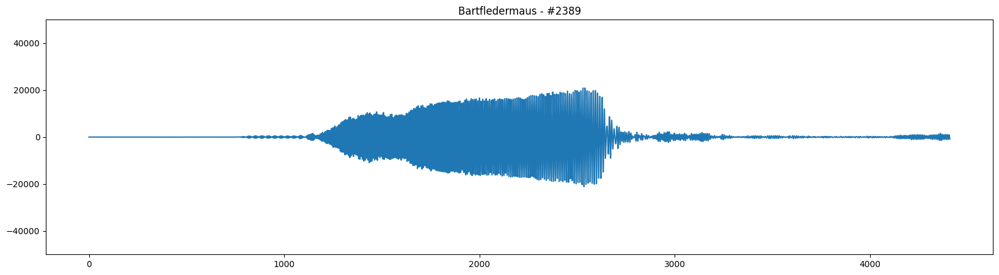

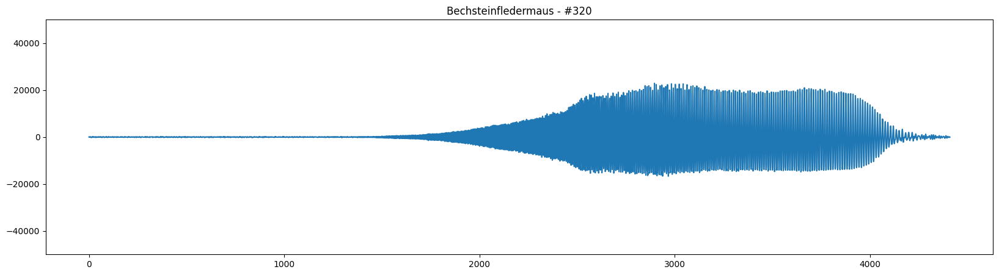

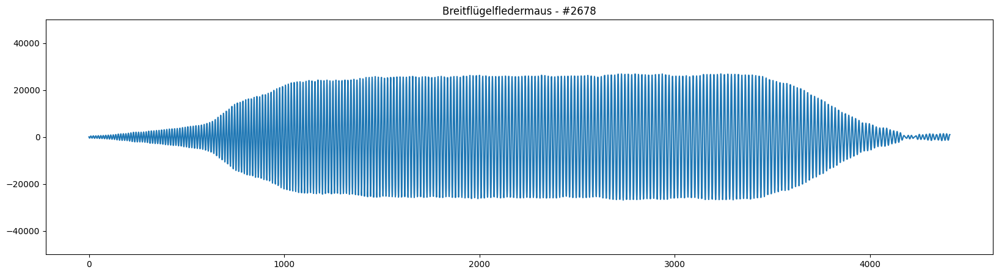

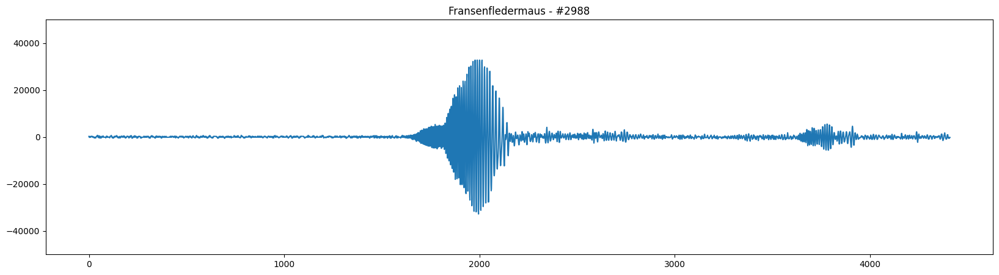

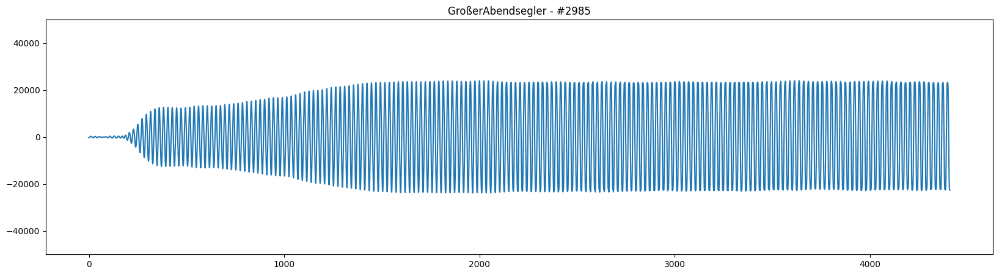

...

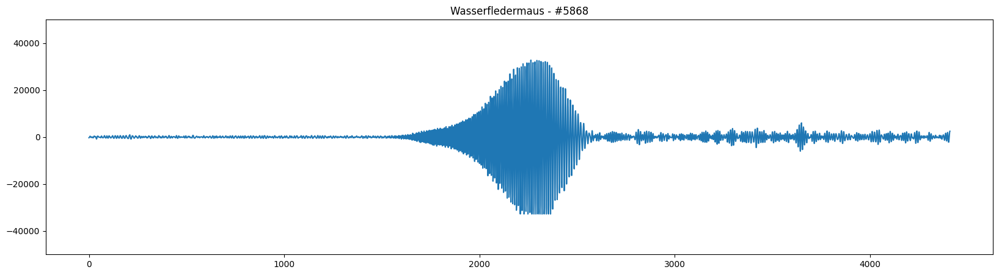

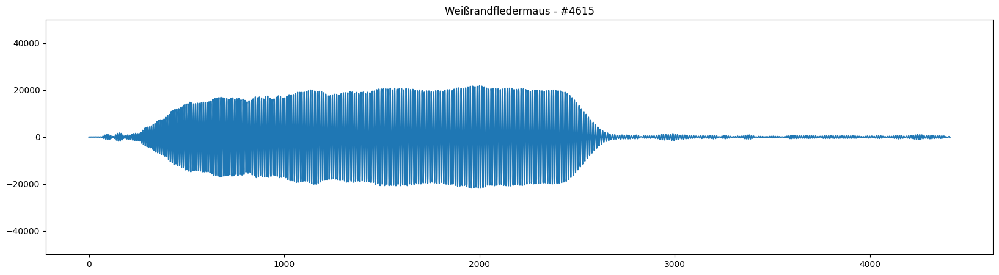

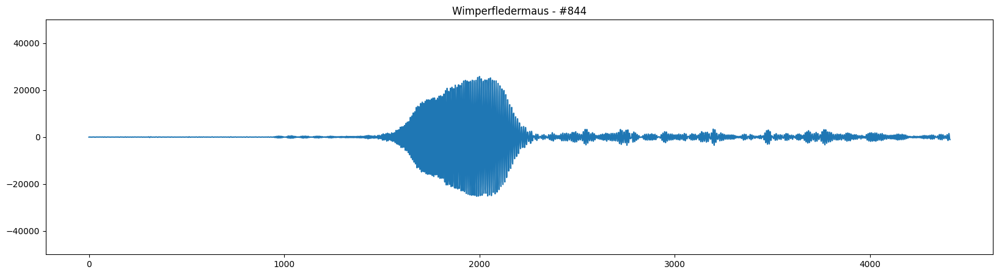

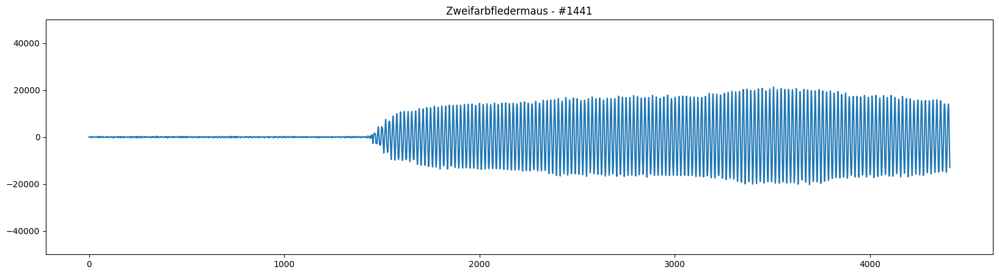

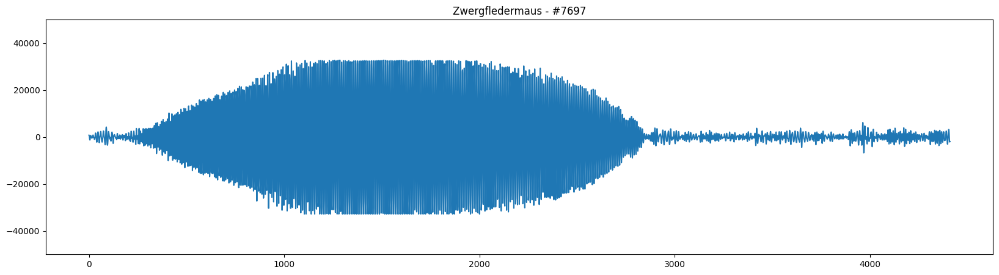

In [10]:
# view targets in seperate
for index, d in distribution.iterrows():
    species = d["bat"]
    bat_data = get_target_data(d["target"], limit=0, no_target=True)
    mask = bat_data > 20000
    loud_bats = bat_data[mask.any(axis=1)]
    count = 0
    fig, ax = plt.subplots()
    for index, b in loud_bats.iterrows():
        count += 1
        # Clear the axis
        ax.clear()
        ax = b.plot(figsize=(20, 5), ax=ax, title=f"{species} - #{index}")
        ax.set_ylim([-50000, 50000])
        plt.savefig(f"LoudBats/{species} - #{index}.png")
    print(f"{species} - Total count loud bats: {count}")

Der Anteil an lauten Fledermäusen (Frequenzen über 20.000 Hz) liegt über die Fledermausarten hinweg zum größten Teil unter 10%. Diese Datensätze werden folgende Versuche der KI-Klassifizierung stärker beeinflussen als Andere.Interessanter weiße gilt das auch für das Rauschen.

In [12]:
# view targets in seperate
for index, d in distribution.iterrows():
    species = d["bat"]
    bat_data = get_target_data(d["target"], limit=0, no_target=True)
    mask = bat_data < 2000
    silent_bats = bat_data[mask.all(axis=1)]
    print(f"{species} - Total count silent bats: {len(silent_bats)}")

Bartfledermaus - Total count silent bats: 1003
Bechsteinfledermaus - Total count silent bats: 21
Breitflügelfledermaus - Total count silent bats: 936
Fransenfledermaus - Total count silent bats: 1406
GroßerAbendsegler - Total count silent bats: 1240
GroßesMausohr - Total count silent bats: 787
KleinerAbendsegler - Total count silent bats: 1437
Langohr - Total count silent bats: 29
Mopsfledermaus - Total count silent bats: 4
Mückenfledermaus - Total count silent bats: 189
Nordfledermaus - Total count silent bats: 337
Rauhautfledermaus - Total count silent bats: 2439
Rauschen - Total count silent bats: 482
Teichfledermaus - Total count silent bats: 932
Wasserfledermaus - Total count silent bats: 2607
Weißrandfledermaus - Total count silent bats: 2083
Wimperfledermaus - Total count silent bats: 310
Zweifarbfledermaus - Total count silent bats: 798
Zwergfledermaus - Total count silent bats: 3609


Wir konnten zuvor bereits sehen, dass für alle Fledermausarten Spektogramme mit über 20.000 Hz existieren wobei der Anteil hier relativ gering war. Nun sehen wir das es weitaus mehr Aufnahmen gibt die nicht über 2.000 Hz hinaus kommen. Zum Teil gibt es Arten bei denen der Anteil nahe an oder sogar über 50% liegt.
Eine naheliegender Schluss wäre die Daten zu skalieren (z.B. in einen Wertebereich zwischen 0 und 1). Man muss jedoch im Hinterkopf behalten, dass beim Hochskalieren auch das Rauschen verstärkt in den Daten verstärkt wird und beim Runterskalieren ggf. Informationen verloren gehen. 

Bartfledermaus - Total count mute bats: 6
Bechsteinfledermaus - Total count mute bats: 0
Breitflügelfledermaus - Total count mute bats: 8
Fransenfledermaus - Total count mute bats: 19
GroßerAbendsegler - Total count mute bats: 0
GroßesMausohr - Total count mute bats: 1
KleinerAbendsegler - Total count mute bats: 26
Langohr - Total count mute bats: 0
Mopsfledermaus - Total count mute bats: 0
Mückenfledermaus - Total count mute bats: 0
Nordfledermaus - Total count mute bats: 8
Rauhautfledermaus - Total count mute bats: 5
Rauschen - Total count mute bats: 446
Teichfledermaus - Total count mute bats: 17
Wasserfledermaus - Total count mute bats: 156
Weißrandfledermaus - Total count mute bats: 9
Wimperfledermaus - Total count mute bats: 0
Zweifarbfledermaus - Total count mute bats: 4
Zwergfledermaus - Total count mute bats: 39


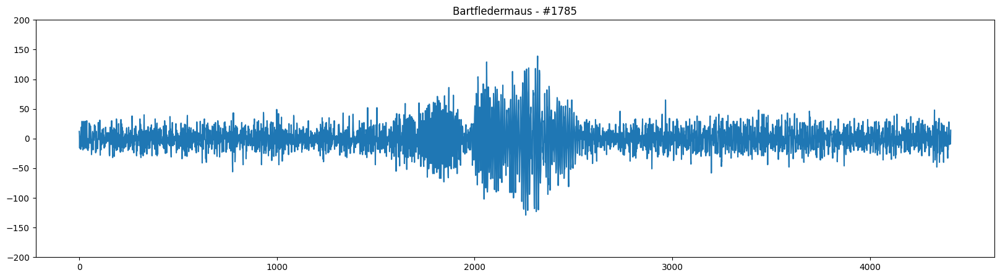

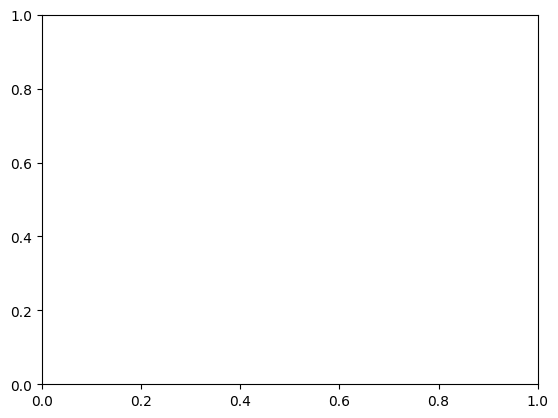

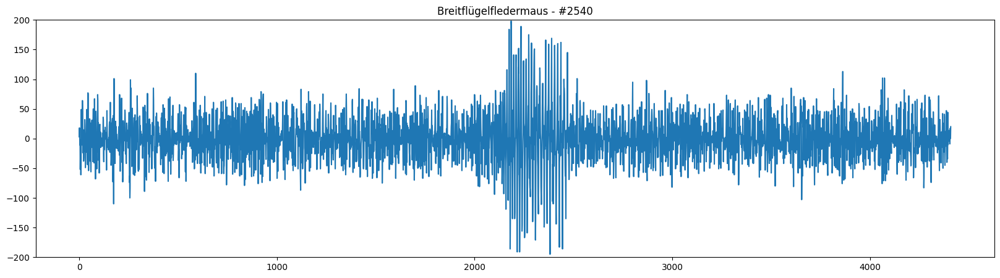

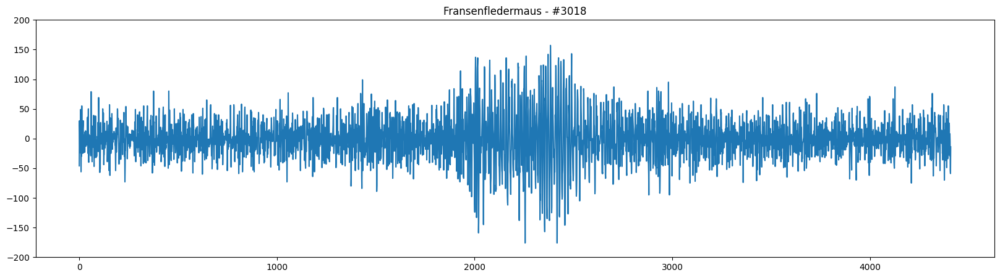

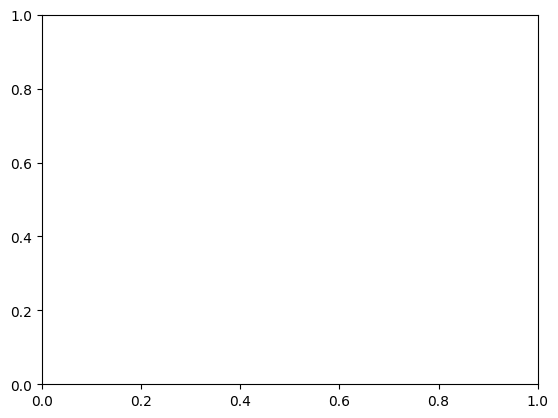

...

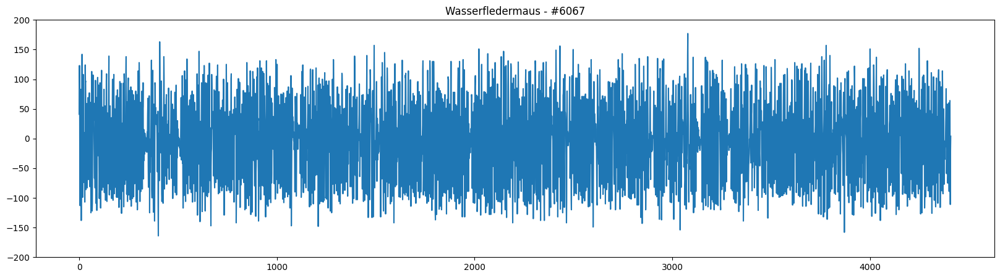

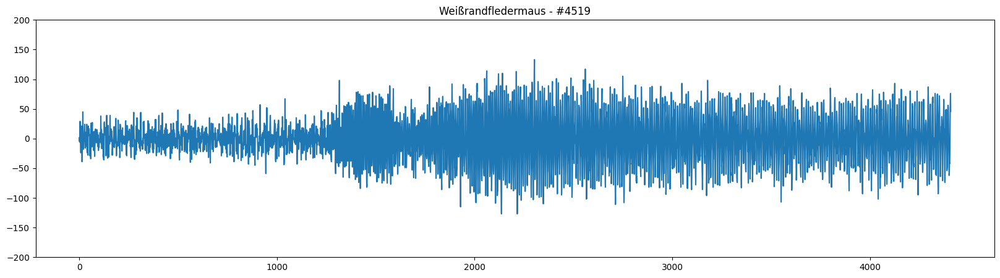

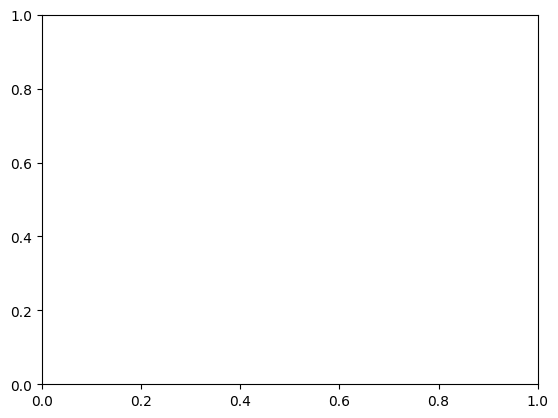

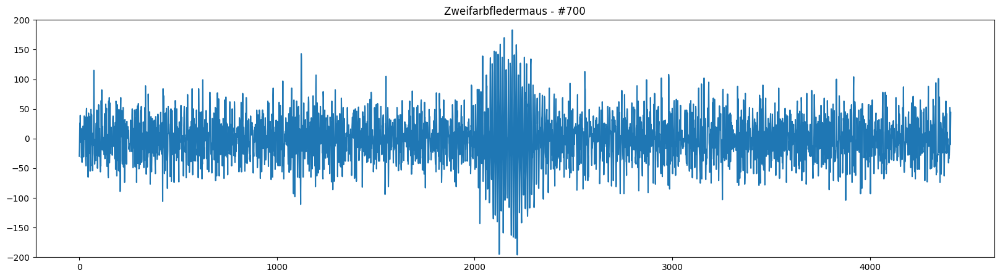

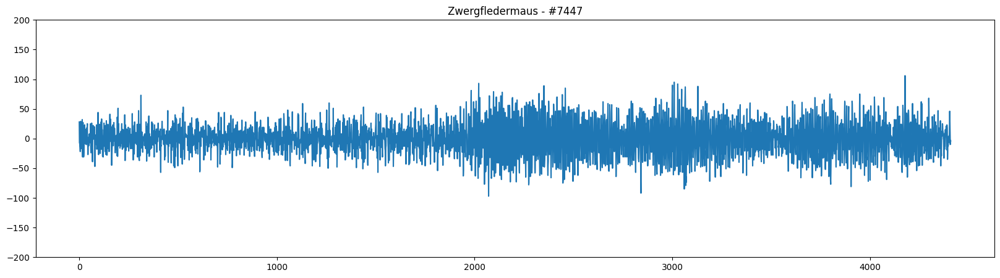

In [13]:
# view targets in seperate
fig, ax = plt.subplots()
for index, d in distribution.iterrows():
    species = d["bat"]
    bat_data = get_target_data(d["target"], limit=0, no_target=True)
    mask = bat_data < 200
    mute_bats = bat_data[mask.all(axis=1)]
    count = 0
    for index, b in mute_bats.iterrows():
        count += 1
        # Clear the axis
        ax.clear()
        ax = b.plot(figsize=(20, 5), ax=ax, title=f"{species} - #{index}")
        ax.set_ylim([-200, 200])
        plt.savefig(f"MuteBats/{species} - #{index}.png")
    print(f"{species} - Total count mute bats: {count}")